# LOAD DATASET AND OTHERS
- The dataset is precomputed in **8kz_dataset_UNET.py**

THE DATASET IS CALCULATED IN THE calculate_8kz_dataset.py, you can find it in the UNET folder. THe dataset is already calculated for this purpose and would be included in the UNET folder

In [30]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from UNET.model import UNetVocalSeparator  
from UNET.data_loader import MusdbDataset

In [31]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
BATCH_SIZE = 16
LR = 2e-4
NUM_EPOCHS = 200
SAMPLE_RATE = 8192
N_FFT = 1024
HOP_LENGTH = 768
PATCH_FRAMES = 128

In [32]:
import torch
from torch.utils.data import Dataset, DataLoader

class FullSpectrogramDataset(Dataset):
    def __init__(self, data_file, patch_frames=None):
        self.data = torch.load(data_file)
        self.patch_frames = patch_frames

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        X, Y = self.data[idx]
        if self.patch_frames is None:
            return X, Y

        n_frames = X.shape[-1]
        if n_frames == self.patch_frames:
            return X, Y
        elif n_frames > self.patch_frames:
            start = torch.randint(0, n_frames - self.patch_frames + 1, (1,)).item()
            Xp = X[:, :, start:start+self.patch_frames]
            Yp = Y[:, :, start:start+self.patch_frames]
            return Xp, Yp
        else:
            raise ValueError(f"Track too short: {n_frames} frames")


In [33]:
train_ds = FullSpectrogramDataset(
    data_file='UNET/full_spectrograms.pt',
    patch_frames=PATCH_FRAMES 
)

train_loader = DataLoader(
    train_ds,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=8,
    pin_memory=True
)

In [24]:
model     = UNetVocalSeparator(base_channels=32).to(DEVICE)
criterion = nn.L1Loss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR) 

# TRAIN THE MODEL

Epoch 001/200 - Training...
Epoch 001  Loss: 0.0027  LR: 0.001000
Epoch 002/200 - Training...
Epoch 002  Loss: 0.0026  LR: 0.001000
Epoch 003/200 - Training...
Epoch 003  Loss: 0.0028  LR: 0.001000
Epoch 004/200 - Training...
Epoch 004  Loss: 0.0025  LR: 0.001000
Epoch 005/200 - Training...
Epoch 005  Loss: 0.0026  LR: 0.001000
Epoch 006/200 - Training...
Epoch 006  Loss: 0.0027  LR: 0.001000
Epoch 007/200 - Training...
Epoch 007  Loss: 0.0026  LR: 0.001000
Epoch 008/200 - Training...
Epoch 008  Loss: 0.0027  LR: 0.001000
Epoch 009/200 - Training...
Epoch 009  Loss: 0.0026  LR: 0.001000
Epoch 010/200 - Training...
Epoch 010  Loss: 0.0026  LR: 0.001000
Epoch 011/200 - Training...
Epoch 011  Loss: 0.0026  LR: 0.001000
Epoch 012/200 - Training...
Epoch 012  Loss: 0.0024  LR: 0.001000
Epoch 013/200 - Training...
Epoch 013  Loss: 0.0027  LR: 0.001000
Epoch 014/200 - Training...
Epoch 014  Loss: 0.0027  LR: 0.001000
Epoch 015/200 - Training...
Epoch 015  Loss: 0.0024  LR: 0.001000
Epoch 016/

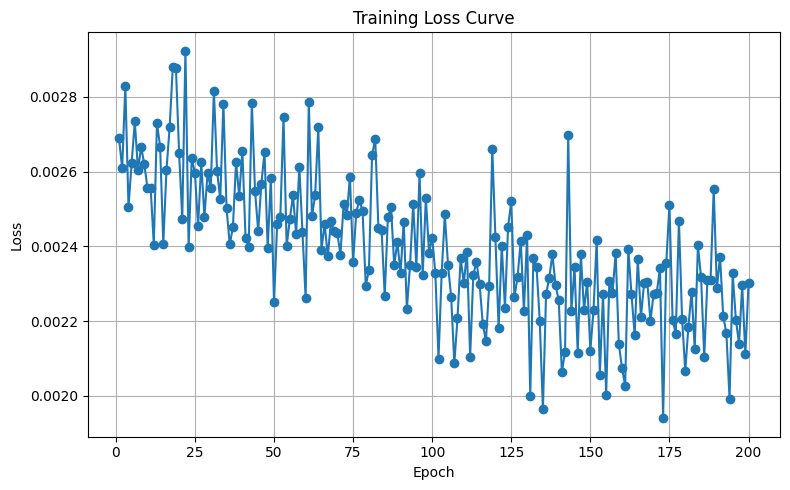

In [27]:
import torch
import matplotlib.pyplot as plt
from torch.optim.lr_scheduler import StepLR

train_losses = []

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = StepLR(optimizer, step_size=100, gamma=0.5)  

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Epoch {epoch:03d}/{NUM_EPOCHS} - Training...")
    model.train()
    running_loss = 0.0

    for X, Y in train_loader:
        X = X.to(DEVICE)
        Y = Y.to(DEVICE)
        
        mask = model(X)
        estimate = mask * X

        loss = criterion(estimate, Y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * X.size(0)

    scheduler.step()

    epoch_loss = running_loss / len(train_ds)
    train_losses.append(epoch_loss)
    
    current_lr = scheduler.get_last_lr()[0]
    print(f"Epoch {epoch:03d}  Loss: {epoch_loss:.4f}  LR: {current_lr:.6f}")

    if epoch % 10 == 0:
        torch.save(model.state_dict(), f'UNET/unet_vocal_epoch{epoch}.pt')


# Plot loss
plt.figure(figsize=(8,5))
plt.plot(range(1, NUM_EPOCHS + 1), train_losses, marker='o')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training Loss Curve")
plt.grid(True)
plt.tight_layout()
plt.show()

# INFERENCE
- ADD A CUSTOM FILE TO **file_path**

In [34]:
import os
import numpy as np
import librosa
import torch
import torch.nn.functional as F
from musdb import DB
from IPython.display import Audio
from UNET.model import UNetVocalSeparator

sr_unet = 8192    
sr_full = 44100 
n_fft = 1024
hop = 768  
base_channels = 32
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetVocalSeparator(base_channels=base_channels).to(DEVICE)
model.load_state_dict(
    torch.load("UNET/unet_vocal_epoch200.pt", map_location=DEVICE)
)
model.eval()

file_path = "Tiptoe_-_Rivers_and_Leafs.mp3"

mix, orig_sr = librosa.load(file_path, sr=None, mono=True)

mix_rs = librosa.resample(mix, orig_sr=orig_sr, target_sr=sr_unet)

# Resample to U-Net rate and STFT
S      = librosa.stft(mix_rs, n_fft=n_fft, hop_length=hop)
mag    = np.abs(S)[:512, :]
phase  = np.angle(S)[:512, :]

# Normalize + pad to multiple of 64 frames
scale   = mag.max() if mag.max() > 0 else 1.0
mag_n   = mag / scale
T       = mag_n.shape[1]
pad     = (64 - (T % 64)) % 64
mag_n   = np.pad(mag_n, ((0,0),(0,pad)), mode='constant')
mag_n   = mag_n[None,None]  # (1,1,512,T+pad)

# U-Net inference
with torch.no_grad():
    m_u = model(torch.from_numpy(mag_n).float().to(DEVICE))
mask_u = m_u.cpu().numpy()[0,0,:,:T]

# Upsample mask to full spec
mask_t  = torch.from_numpy(mask_u[None,None]).float()
mask_f  = F.interpolate(
    mask_t, size=mag.shape, mode='bilinear', align_corners=False
)[0,0].numpy()

# Reconstruct at U-Net rate and resample to full-rate
vocal_mag = mask_f * mag
full_spec = np.pad(vocal_mag * np.exp(1j * phase),
                   ((0, n_fft//2+1-512),(0,0)), mode='constant')
vocals    = librosa.istft(full_spec, hop_length=hop, win_length=n_fft)
vocals_44 = librosa.resample(vocals, orig_sr=sr_unet, target_sr=sr_full)

# Play separated vocals
# display(Audio(vocals_44, rate=sr_full))
# Might throw a multi processing thread warning, but it should work regardless

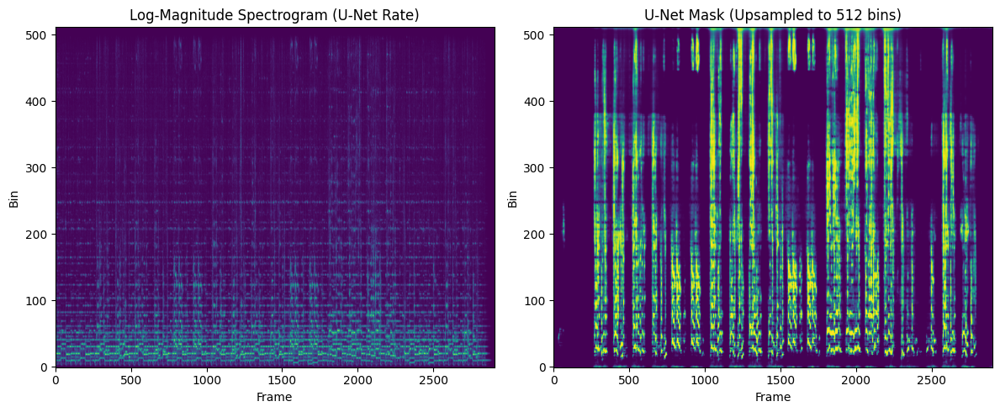

In [35]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title("Log-Magnitude Spectrogram (U-Net Rate)")
plt.imshow(np.log1p(mag), origin="lower", aspect="auto")
plt.xlabel("Frame"); plt.ylabel("Bin")

plt.subplot(1, 2, 2)
plt.title("U-Net Mask (Upsampled to 512 bins)")
plt.imshow(mask_f, origin="lower", aspect="auto")
plt.xlabel("Frame"); plt.ylabel("Bin")

plt.tight_layout()
plt.show()
